In [1]:
from PIL import Image
import numpy as np
from PIL import ImageChops
import matplotlib.pyplot as plt

tryb RGB
format JPEG
rozmiar (1920, 1080)


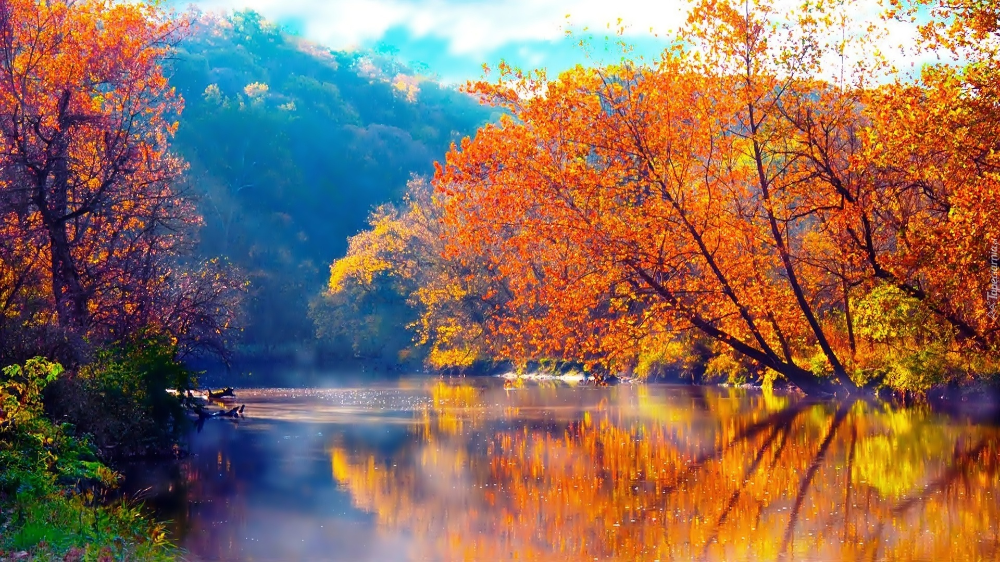

In [2]:
im = Image.open('jesien.jpg')
print("tryb", im.mode)
print("format", im.format)
print("rozmiar", im.size)
h, w = im.size
im

In [3]:
# tablica obrazu
T = np.array(im)
print("typ danych tablicy obrazu: ", T.dtype)
print("rozmiar elementu tablicy obrazu: ", T.itemsize)
print("rozmiar tablicy obrazu: ", T.shape)

typ danych tablicy obrazu:  uint8
rozmiar elementu tablicy obrazu:  1
rozmiar tablicy obrazu:  (1080, 1920, 3)


Pobieranie tablic kanałów


In [4]:
#tablica kanału r
t_r = T[:, :, 0]
print("typ danych tablicy kanału r: ", t_r.dtype)
print("rozmiar elemntu tablicy kanału r: ",t_r.itemsize)
print("rozmiar tablicy kanału r: ",t_r.shape)

im_r = Image.fromarray(t_r) # obraz w odcieniuach szarości kanału r
print("tryb kanału r: ", im_r.mode)

#tablica kanału g
t_g = T[:, :, 1]
im_g = Image.fromarray(t_g) # obraz w odcieniuach szarości kanału g
#tablica kanału b
t_b = T[:, :, 2]
im_b = Image.fromarray(t_b) # obraz w odcieniuach szarości kanału b




typ danych tablicy kanału r:  uint8
rozmiar elemntu tablicy kanału r:  1
rozmiar tablicy kanału r:  (1080, 1920)
tryb kanału r:  L


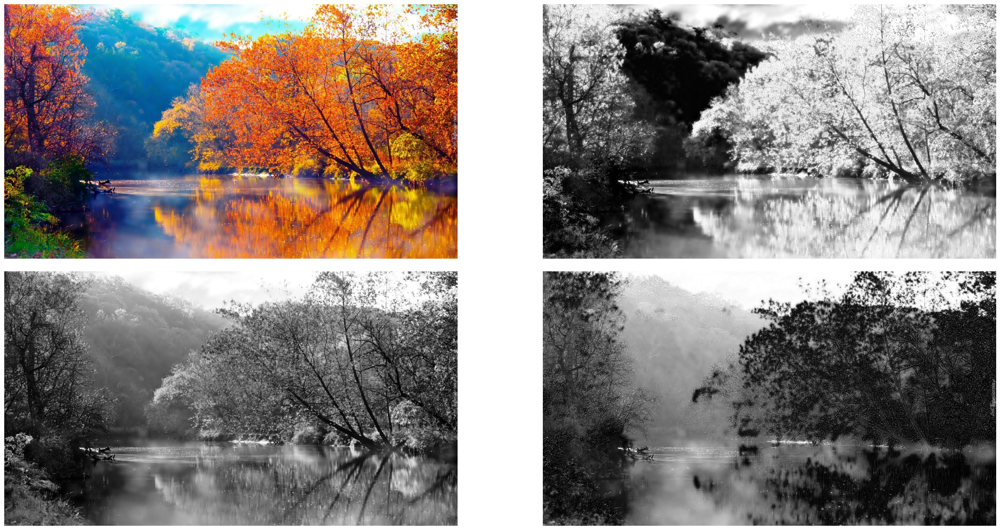

In [16]:
# przedstawienie 4 obrazów w jednym oknie plt
plt.figure(figsize=(32, 16))
plt.subplot(2,2,1) # ile obrazów w pionie, ile w poziomie, numer obrazu
plt.imshow(im)
plt.axis('off')
plt.subplot(2,2,2)
plt.imshow(im_r, "gray")
plt.axis('off')
plt.subplot(2,2,3)
plt.imshow(im_g, "gray")
plt.axis('off')
plt.subplot(2,2,4)
plt.imshow(im_b, "gray")
plt.axis('off')
plt.subplots_adjust(wspace=0.05, hspace=0.05)
plt.savefig('figura1.png')
plt.show()



Kanały pobrane jako obrazy - metoda split

In [6]:
r, g, b = im.split()  # powstają obrazy w trybie L
print("tryb kanału r: ", r.mode)
print("tryb kanału g: ", g.mode)
print("tryb kanału b: ", b.mode)


tryb kanału r:  L
tryb kanału g:  L
tryb kanału b:  L


In [7]:
# porównanie obu metod pozyskania kanałów
# ImageChops.difference daje obraz, kórego piksele powstają
# jako wartość bezwzględna różnicy pikseli

diff_r = ImageChops.difference(r, im_r)
diff_g = ImageChops.difference(g, im_g)
diff_b = ImageChops.difference(b, im_b)



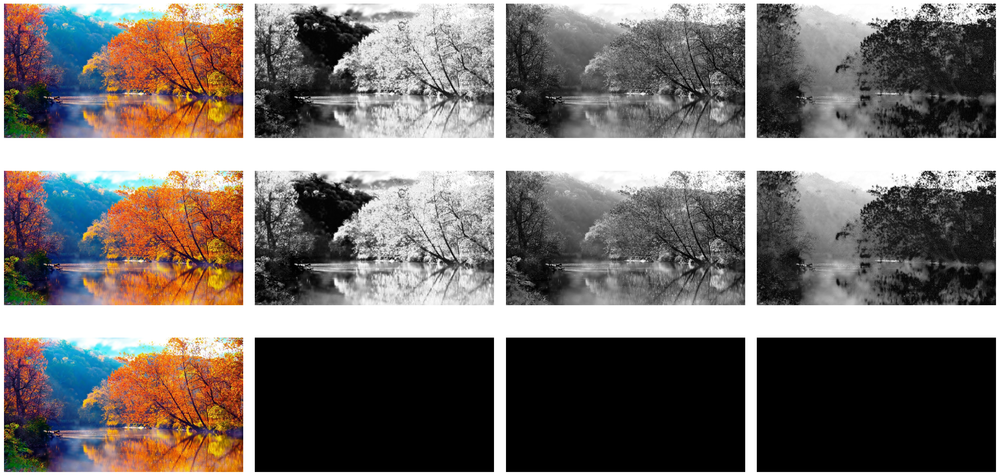

In [8]:
# przedstawienie na jednej figurze plt

plt.figure(figsize=(32, 16))
plt.subplot(3,4,1) 
plt.imshow(im)
plt.axis('off')
plt.subplot(3,4,2)
plt.imshow(im_r, "gray")
plt.axis('off')
plt.subplot(3,4,3)
plt.imshow(im_g, "gray")
plt.axis('off')
plt.subplot(3,4,4)
plt.imshow(im_b, "gray")
plt.axis('off')
plt.subplot(3,4,5)
plt.imshow(im)
plt.axis('off')
plt.subplot(3,4,6)
plt.imshow(r, "gray")
plt.axis('off')
plt.subplot(3,4,7)
plt.imshow(g, "gray")
plt.axis('off')
plt.subplot(3,4,8)
plt.imshow(b, "gray")
plt.axis('off')
plt.subplot(3,4,9)
plt.imshow(im)
plt.axis('off')
plt.subplot(3,4,10)
plt.imshow(diff_r, "gray")
plt.axis('off')
plt.subplot(3,4,11)
plt.imshow(diff_g, "gray")
plt.axis('off')
plt.subplot(3,4,12)
plt.imshow(diff_b, "gray")
plt.axis('off')
plt.subplots_adjust(wspace=0.05, hspace=0.05)
plt.show()


Łączenie kanałow w jeden obraz RGB - metoda merge


In [9]:
im1 = Image.merge('RGB', (im_r, im_g, im_b))
im2 = Image.merge('RGB', (r, g, b)) 
im3 = Image.merge('RGB', (r, im_g, b))


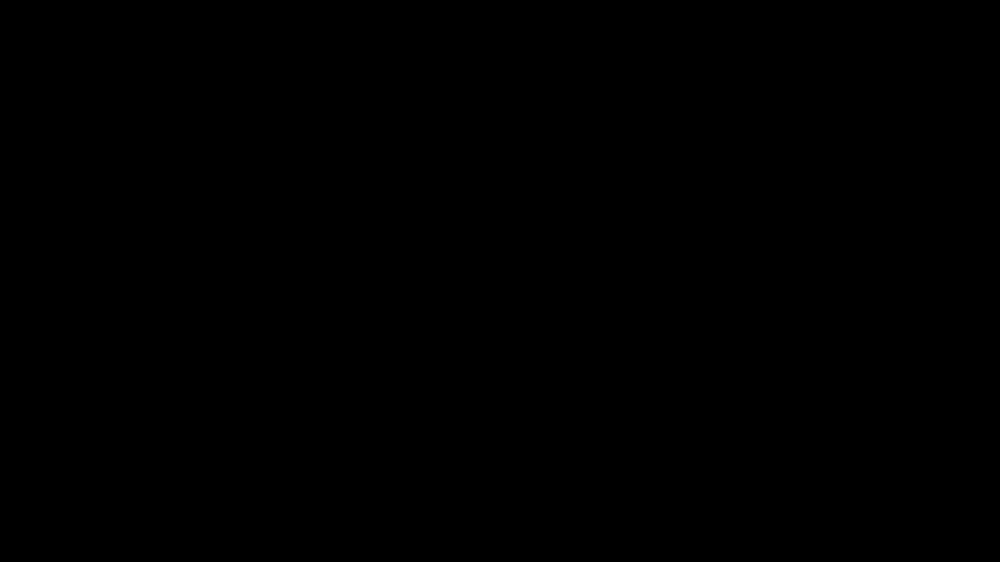

In [10]:
ImageChops.difference(im1,im2)



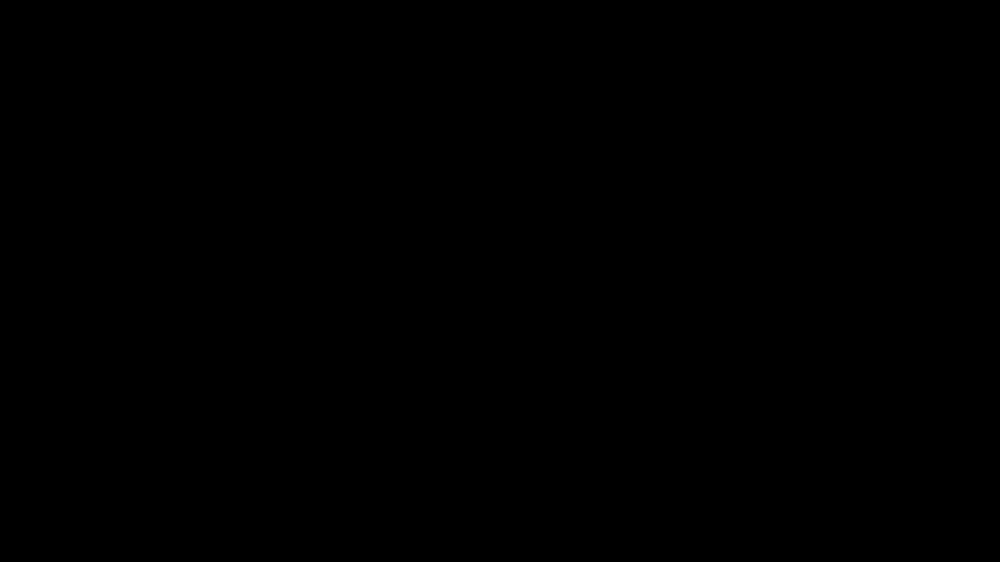

In [11]:
ImageChops.difference(im1,im3)


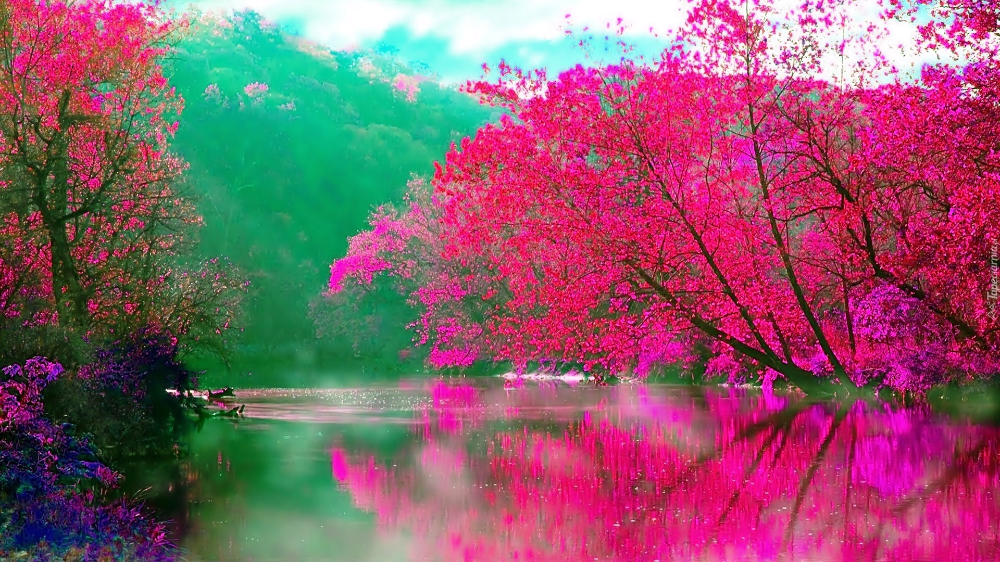

In [12]:
# efekt przestawienia  kanałow
im3 = Image.merge('RGB', (r, b, g))
im3

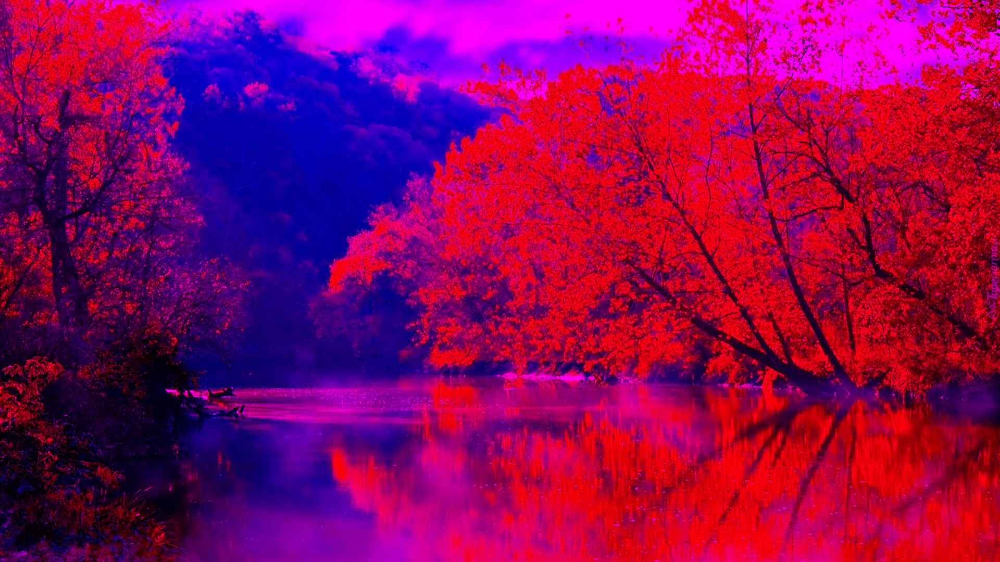

In [13]:
# własny obraz w trybie L jako kanał
t = (w, h)
A = np.zeros(t, dtype=np.uint8)
A_im = Image.fromarray(A)

im4 = Image.merge('RGB', (r, A_im, b))
im4

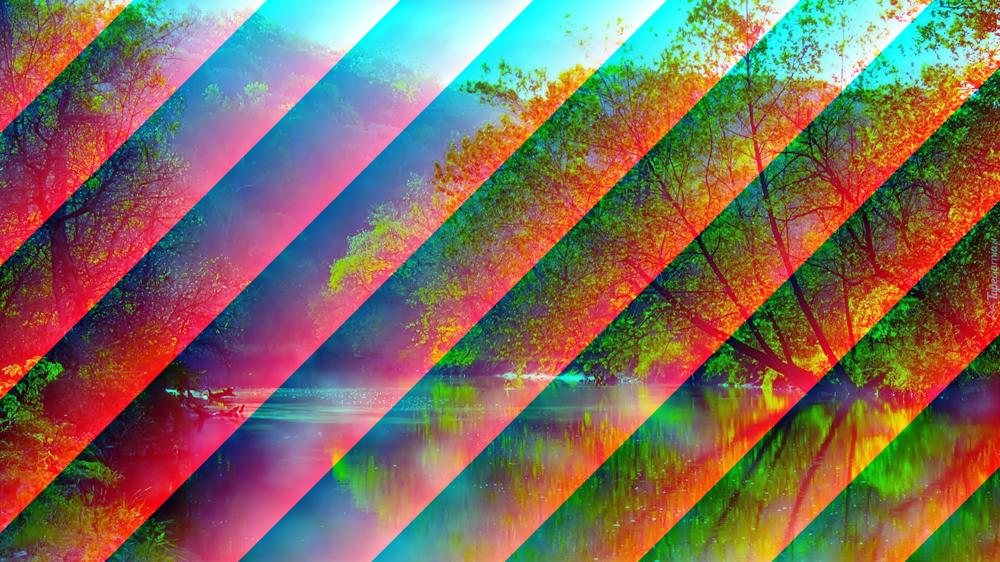

In [14]:
# własny obraz w trybie L jako kanał - drugi przykład
B = np.ones(t, dtype=np.uint8)
for i in range(w):
    for j in range(h):
        B[i, j] = (i + j) % 256

B_im = Image.fromarray(B)
im5 = Image.merge('RGB', (B_im, g, b))
im5
